In [38]:
import numpy as np 
import pandas as pd 
import matplotlib.pyplot as plt 
import seaborn as sns


In [39]:
data = pd.read_csv('../data/data.csv')
data.head()

,id,diagnosis,radius_mean,texture_mean,perimeter_mean,area_mean,smoothness_mean,compactness_mean,concavity_mean,concave points_mean,...,texture_worst,perimeter_worst,area_worst,smoothness_worst,compactness_worst,concavity_worst,concave points_worst,symmetry_worst,fractal_dimension_worst,Unnamed: 32
0,842302,M,17.99,10.38,122.80,1001.0,0.11840,0.27760,0.3001,0.14710,...,17.33,184.60,2019.0,0.1622,0.6656,0.7119,0.2654,0.4601,0.11890,NaN
1,842517,M,20.57,17.77,132.90,1326.0,0.08474,0.07864,0.0869,0.07017,...,23.41,158.80,1956.0,0.1238,0.1866,0.2416,0.1860,0.2750,0.08902,NaN
2,84300903,M,19.69,21.25,130.00,1203.0,0.10960,0.15990,0.1974,0.12790,...,25.53,152.50,1709.0,0.1444,0.4245,0.4504,0.2430,0.3613,0.08758,NaN
3,84348301,M,11.42,20.38,77.58,386.1,0.14250,0.28390,0.2414,0.10520,...,26.50,98.87,567.7,0.2098,0.8663,0.6869,0.2575,0.6638,0.17300,NaN
4,84358402,M,20.29,14.34,135.10,1297.0,0.10030,0.13280,0.1980,0.10430,...,16.67,152.20,1575.0,0.1374,0.2050,0.4000,0.1625,0.2364,0.07678,NaN


In [40]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 569 entries, 0 to 568
Data columns (total 33 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   id                       569 non-null    int64  
 1   diagnosis                569 non-null    object 
 2   radius_mean              569 non-null    float64
 3   texture_mean             569 non-null    float64
 4   perimeter_mean           569 non-null    float64
 5   area_mean                569 non-null    float64
 6   smoothness_mean          569 non-null    float64
 7   compactness_mean         569 non-null    float64
 8   concavity_mean           569 non-null    float64
 9   concave points_mean      569 non-null    float64
 10  symmetry_mean            569 non-null    float64
 11  fractal_dimension_mean   569 non-null    float64
 12  radius_se                569 non-null    float64
 13  texture_se               569 non-null    float64
 14  perimeter_se             5

In [41]:
data.describe().transpose()

,count,mean,std,min,25%,50%,75%,max
id,569.0,3.037183e+07,1.250206e+08,8670.000000,869218.000000,906024.000000,8.813129e+06,9.113205e+08
radius_mean,569.0,1.412729e+01,3.524049e+00,6.981000,11.700000,13.370000,1.578000e+01,2.811000e+01
texture_mean,569.0,1.928965e+01,4.301036e+00,9.710000,16.170000,18.840000,2.180000e+01,3.928000e+01
perimeter_mean,569.0,9.196903e+01,2.429898e+01,43.790000,75.170000,86.240000,1.041000e+02,1.885000e+02
area_mean,569.0,6.548891e+02,3.519141e+02,143.500000,420.300000,551.100000,7.827000e+02,2.501000e+03
smoothness_mean,569.0,9.636028e-02,1.406413e-02,0.052630,0.086370,0.095870,1.053000e-01,1.634000e-01
compactness_mean,569.0,1.043410e-01,5.281276e-02,0.019380,0.064920,0.092630,1.304000e-01,3.454000e-01
concavity_mean,569.0,8.879932e-02,7.971981e-02,0.000000,0.029560,0.061540,1.307000e-01,4.268000e-01
concave points_mean,569.0,4.891915e-02,3.880284e-02,0.000000,0.020310,0.033500,7.400000e-02,2.012000e-01
symmetry_mean,569.0,1.811619e-01,2.741428e-02,0.106000,0.161900,0.179200,1.957000e-01,3.040000e-01


In [42]:
data = data.drop('Unnamed: 32', axis =1)

In [43]:
#data['diagnosis'] = data['diagnosis'].map({'M':1, 'B':0})

In [37]:
# Creating a list of columns with only the columns that represent the mean.
mean_columns = data[[ 'diagnosis','radius_mean', 'texture_mean', 'perimeter_mean',
             'area_mean', 'smoothness_mean', 'compactness_mean', 'concavity_mean',
             'concave points_mean', 'symmetry_mean', 'fractal_dimension_mean']]
# Creating a list of columns with only the columns that represent the standard error .             
se_columns = data[['diagnosis','radius_se', 'texture_se', 'perimeter_se', 'area_se', 'smoothness_se',
       'compactness_se', 'concavity_se', 'concave points_se', 'symmetry_se',
       'fractal_dimension_se']]
# Creating a list of columns with only the columns that represent the worst values.
worst_columns = data[['diagnosis','radius_worst', 'texture_worst',
              'perimeter_worst', 'area_worst', 'smoothness_worst',
              'compactness_worst', 'concavity_worst', 'concave points_worst',
              'symmetry_worst', 'fractal_dimension_worst']]


In [44]:
def plot_hist(df:pd.DataFrame, column:str, color:str)->None:
    # plt.figure(figsize=(15, 10))
    # fig, ax = plt.subplots(1, figsize=(12, 7))
    sns.displot(data=df, x=column, color=color, kde=True, height=7, aspect=2)
    plt.title(f'Distribution of {column}', size=20, fontweight='bold')
    plt.show()

def plot_count(df:pd.DataFrame, column:str) -> None:
    plt.figure(figsize=(12, 7))
    sns.countplot(data=df, x=column)
    plt.title(f'Distribution of {column}', size=20, fontweight='bold')
    plt.show()
    
def plot_bar(df:pd.DataFrame, x_col:str, y_col:str, title:str, xlabel:str, ylabel:str)->None:
    plt.figure(figsize=(12, 7))
    sns.barplot(data = df, x=x_col, y=y_col)
    plt.title(title, size=20)
    plt.xticks(rotation=75, fontsize=14)
    plt.yticks( fontsize=14)
    plt.xlabel(xlabel, fontsize=16)
    plt.ylabel(ylabel, fontsize=16)
    plt.show()

def plot_heatmap(df:pd.DataFrame, title:str, cbar=False)->None:
    plt.figure(figsize=(12, 7))
    sns.heatmap(df, annot=True, cmap='viridis', vmin=0, vmax=1, fmt='.2f', linewidths=.7, cbar=cbar )
    plt.title(title, size=18, fontweight='bold')
    plt.show()

def plot_box(df:pd.DataFrame, x_col:str, title:str) -> None:
    plt.figure(figsize=(12, 7))
    sns.boxplot(data = df, x=x_col)
    plt.title(title, size=20)
    plt.xticks(rotation=75, fontsize=14)
    plt.show()

def plot_box_multi(df:pd.DataFrame, x_col:str, y_col:str, title:str) -> None:
    plt.figure(figsize=(12, 7))
    sns.boxplot(data = df, x=x_col, y=y_col)
    plt.title(title, size=20)
    plt.xticks(rotation=75, fontsize=14)
    plt.yticks( fontsize=14)
    plt.show()

def plot_scatter(df: pd.DataFrame, x_col: str, y_col: str, title: str, hue: str, style: str) -> None:
    plt.figure(figsize=(12, 7))
    sns.scatterplot(data = df, x=x_col, y=y_col, hue=hue, style=style)
    plt.title(title, size=20)
    plt.xticks(fontsize=14)
    plt.yticks( fontsize=14)
    plt.show()

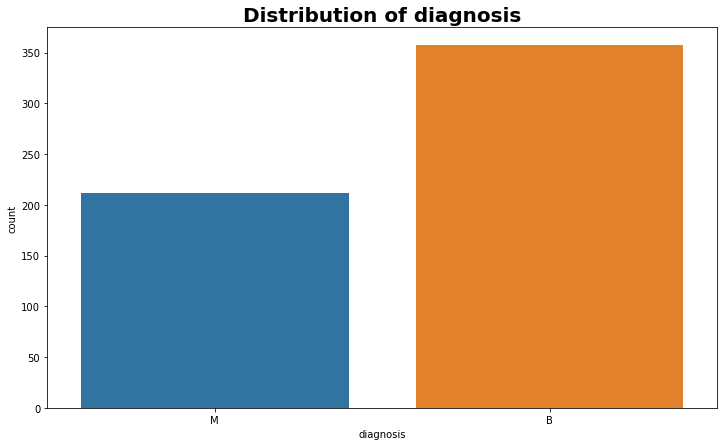

In [14]:
plot_count(data,'diagnosis')

In [45]:
def heat(data, color, size):
    
    corr = data.corr()
    mask = np.zeros_like(corr, dtype=np.bool)
    mask[np.triu_indices_from(corr)] = True
    
    plt.figure(figsize=size)
    sns.heatmap(corr, mask=mask, annot=True, cmap=color)
    plt.show()

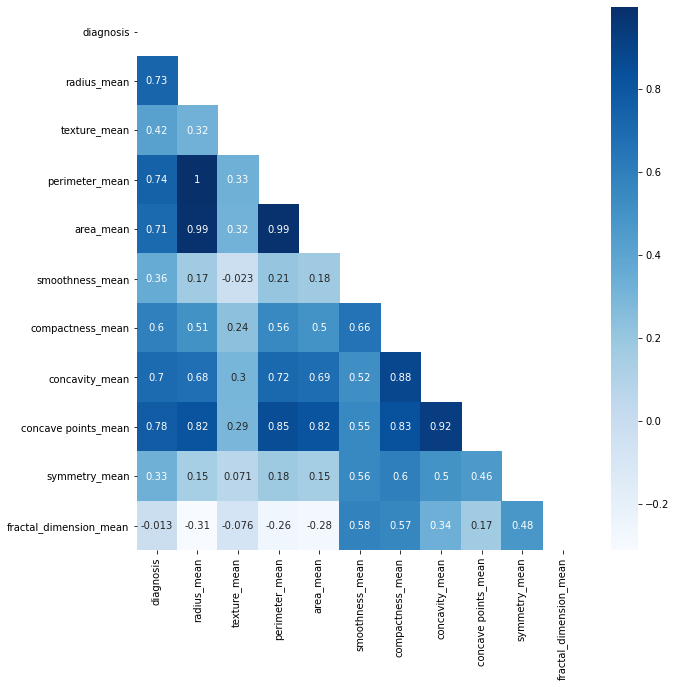

In [46]:
heat(mean_columns,'Blues',(10,10))

    High Positive Correlation between 
1. radius_mean and perimeter_mean
2. radius_mean and area_mean
3.radius_mean and concave_points_mean
4.perimeter_mean and area_mean
5.perimeter_mean and concave_points_mean
6.area_mean and concave_points_mean
7.compactness_mean and concavity_mean
8.compactness_mean and concave points_mean
9.concavity_mean and concave points_mean

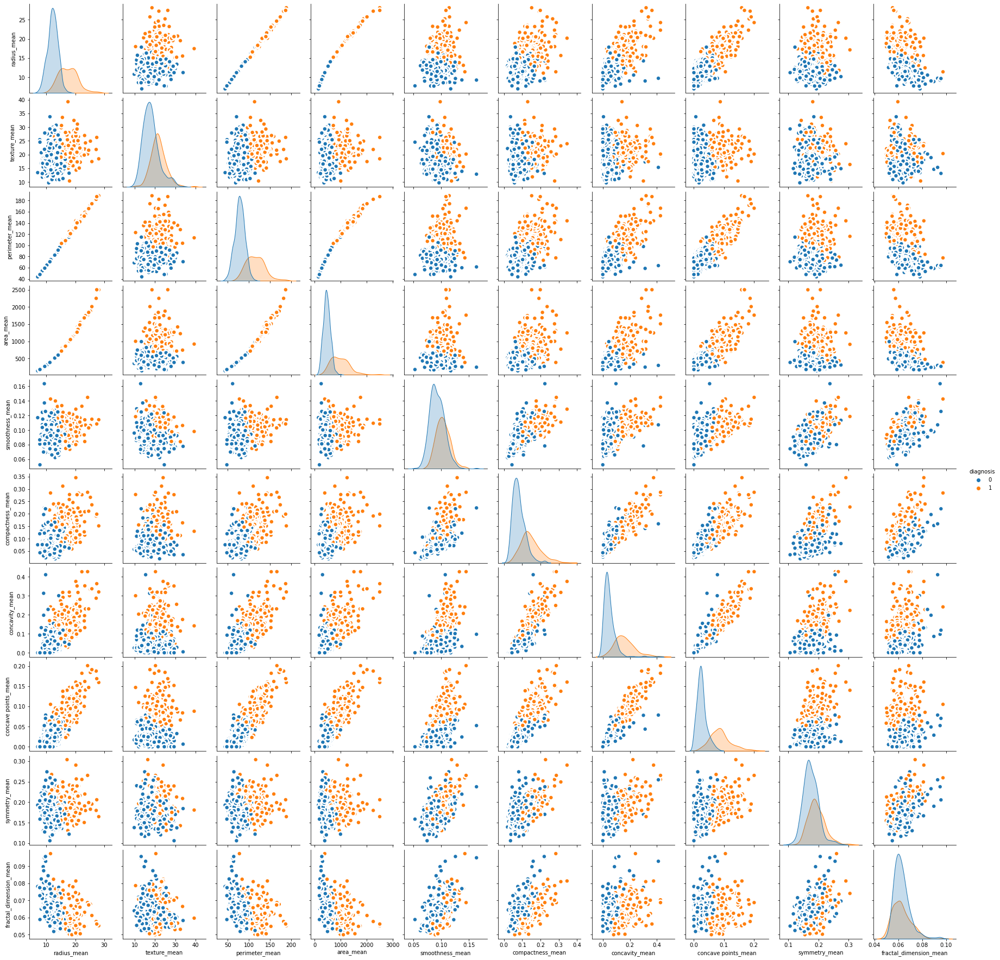

In [47]:
sns.pairplot(mean_columns, kind="scatter", hue="diagnosis", plot_kws=dict(s=80, edgecolor="white", linewidth=2.5))
plt.show()

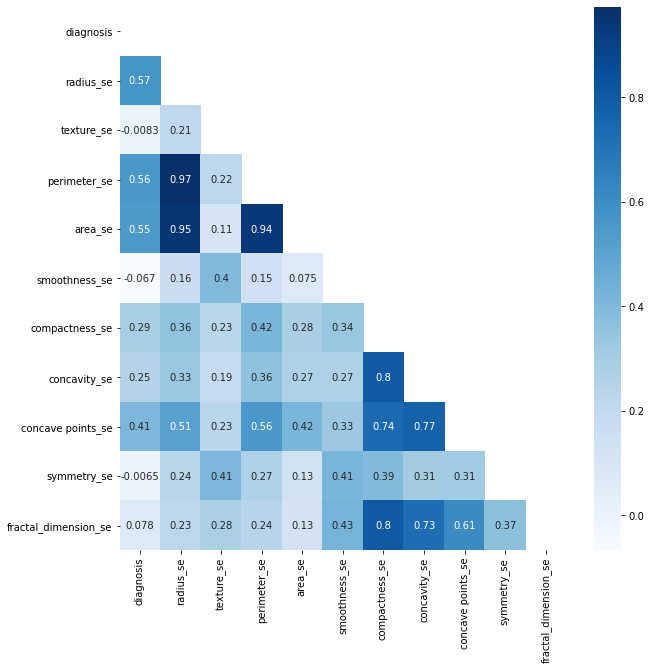

In [48]:
heat(se_columns,'Blues',(10,10))

In [ ]:
# High Positive Correlation between 
# 1. radius_se and perimeter_se
# 2. radius_se and area_se
# 3.radius_se and concave_points_se
# 4.perimeter_se and area_se
# 5.compactness_se and concavity_se

<function matplotlib.pyplot.show(close=None, block=None)>

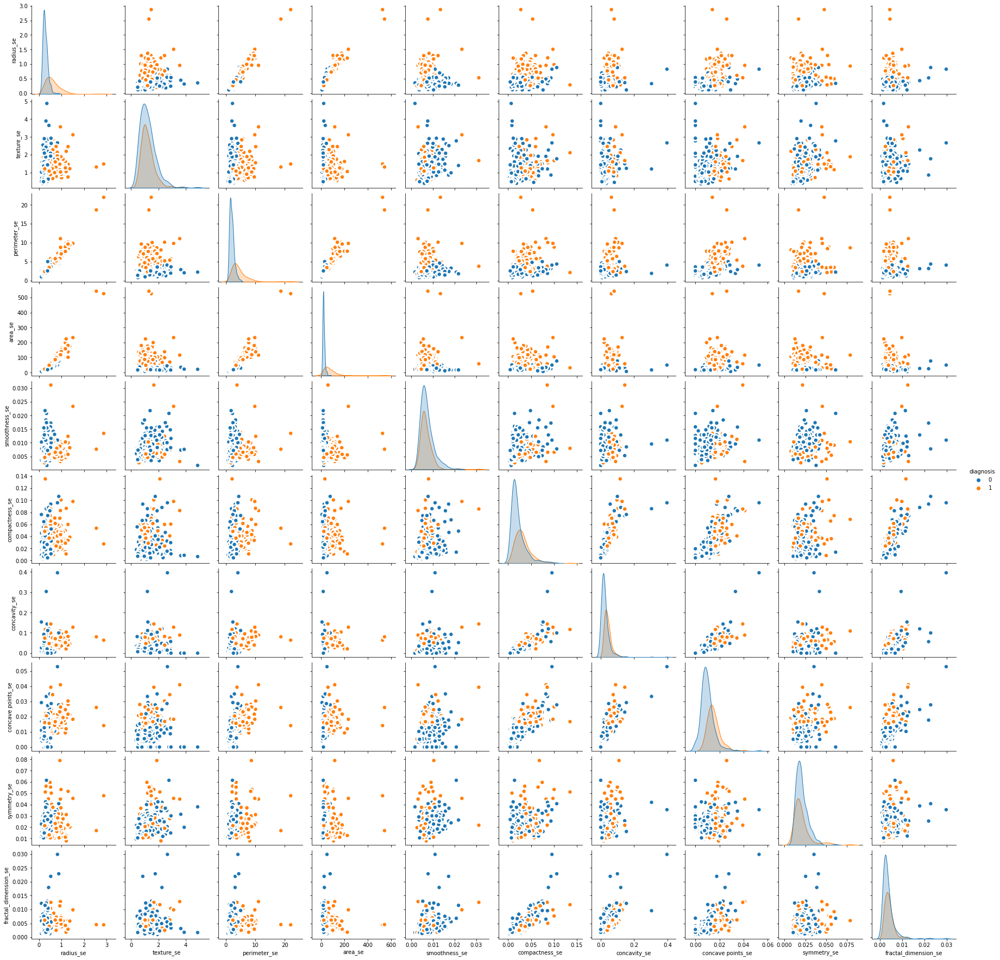

In [51]:
sns.pairplot(se_columns, kind="scatter", hue="diagnosis", plot_kws=dict(s=80, edgecolor="white", linewidth=2.5))
plt.show

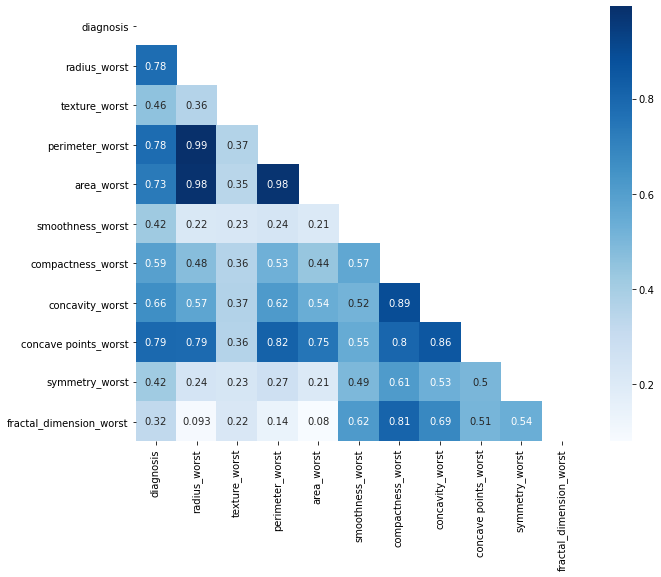

In [52]:
heat(worst_columns,'Blues',(10,8))

In [ ]:
# High Positive Correlation between 
# 1. radius_worst and perimeter_worst
# 2. radius_worst and area_worst
# 3.radius_worst and concave_points_worst
# 4.perimeter_worst and area_worst
# 5.perimeter_worst and concave_points_worst
# 6.area_worst and concave_points_worst
# 7.compactness_worst and concavity_worst
# 8.compactness_worst and concavity_points_worst
# 9.concavity_worst and concavity_points_worst

<function matplotlib.pyplot.show(close=None, block=None)>

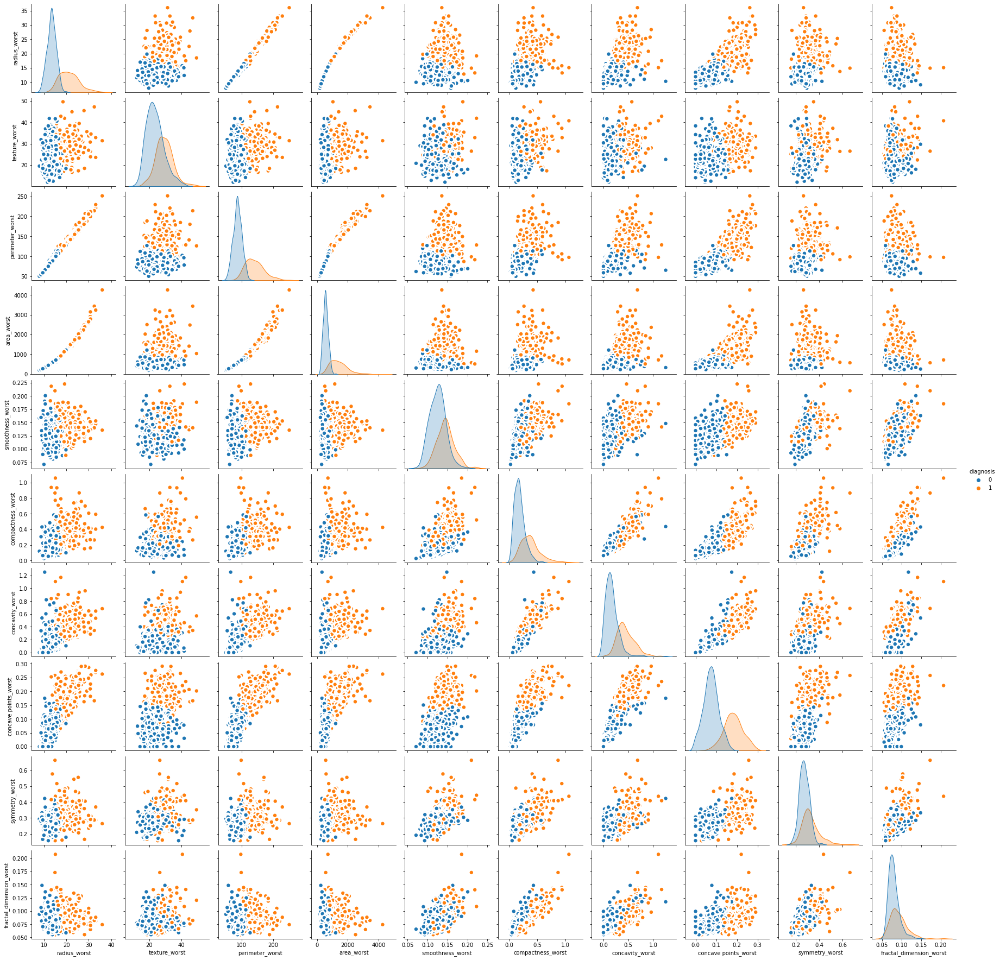

In [53]:
sns.pairplot(worst_columns, kind="scatter", hue="diagnosis", plot_kws=dict(s=80, edgecolor="white", linewidth=2.5))
plt.show

In [ ]:
#compairing the area of a normal cell and a cancer cell
#records which were diagnosed as malignant
M_data = data[data['diagnosis']==1]

#records which diagnosed as benign
B_data = data[data['diagnosis']==0]

##############################################

sns.set(style="darkgrid")
plt.figure(figsize=(10,6))
fig = sns.kdeplot(M_data['area_mean'], shade=True, color="r")
fig = sns.kdeplot(M_data['area_worst'], shade=True, color="r")
fig = sns.kdeplot(B_data['area_mean'], shade=True, color="b")
fig = sns.kdeplot(B_data['area_worst'], shade=True, color="b")
plt.legend()
plt.show()